### Cab Catchers

In [1]:
import pyarrow.parquet as pq
import pandas as pd
import hvplot.pandas 
import glob
from pathlib import Path
import random

In [2]:
taxi_zone_df = pd.read_csv(Path('./Resources/taxi+_zone_lookup.csv'))

In [3]:
taxi_zone_df.dropna(how='any', inplace=True)

In [4]:
# fhv_taxi_032023 = pd.DataFrame()
# fhv_trip = pq.read_table('./Resources/fhv_tripdata_2023-03.parquet')
# fhv_taxi_032023 = fhv_trip.to_pandas()
# display(fhv_taxi_032023.shape) 

In [5]:
#fhv_taxi_032023.to_csv('./Resources/fhv_taxi_032023.csv')

In [6]:
green_taxi_trips_df = pd.DataFrame()
for fname in glob.glob('./Resources/green_trip*.parquet'):
    trips = pq.read_table(fname)
    trips = trips.to_pandas()
    green_taxi_trips_df = pd.concat([green_taxi_trips_df,trips],axis=0)
display(green_taxi_trips_df.shape)

(840402, 20)

In [7]:
green_taxi_trips_df.head()

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge
0,2,2022-01-01 00:14:21,2022-01-01 00:15:33,N,1.0,42,42,1.0,0.44,3.5,0.50,0.5,0.00,0.0,None,0.3,4.80,2.0,1.0,0.00
1,1,2022-01-01 00:20:55,2022-01-01 00:29:38,N,1.0,116,41,1.0,2.10,9.5,0.50,0.5,0.00,0.0,None,0.3,10.80,2.0,1.0,0.00
2,1,2022-01-01 00:57:02,2022-01-01 01:13:14,N,1.0,41,140,1.0,3.70,14.5,3.25,0.5,4.60,0.0,None,0.3,23.15,1.0,1.0,2.75
3,2,2022-01-01 00:07:42,2022-01-01 00:15:57,N,1.0,181,181,1.0,1.69,8.0,0.50,0.5,0.00,0.0,None,0.3,9.30,2.0,1.0,0.00
4,2,2022-01-01 00:07:50,2022-01-01 00:28:52,N,1.0,33,170,1.0,6.26,22.0,0.50,0.5,5.21,0.0,None,0.3,31.26,1.0,1.0,2.75


In [8]:
green_taxi_trips_df.drop(columns=['VendorID','ehail_fee','congestion_surcharge','store_and_fwd_flag','extra','mta_tax','improvement_surcharge'],inplace=True)

In [9]:
green_taxi_trips_df.isnull().sum()

lpep_pickup_datetime         0
lpep_dropoff_datetime        0
RatecodeID               90340
PULocationID                 0
DOLocationID                 0
passenger_count          90340
trip_distance                0
fare_amount                  0
tip_amount                   0
tolls_amount                 0
total_amount                 0
payment_type             90340
trip_type                90355
dtype: int64

In [10]:
green_taxi_trips_df.describe()

,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,tip_amount,tolls_amount,total_amount,payment_type,trip_type
count,750062.000000,840402.000000,840402.000000,750062.000000,840402.000000,840402.000000,840402.000000,840402.000000,840402.000000,750062.000000,750047.000000
mean,1.224952,99.802516,138.512521,1.287703,84.454130,15.294517,2.005268,0.248204,19.322237,1.373006,1.047505
std,1.007635,63.640210,76.908870,0.923323,3244.597234,15.180127,3.179140,1.355336,16.998819,0.504560,0.212717
min,1.000000,1.000000,1.000000,0.000000,0.000000,-350.080000,-14.300000,-6.550000,-350.380000,1.000000,1.000000
25%,1.000000,65.000000,74.000000,1.000000,1.150000,7.500000,0.000000,0.000000,10.260000,1.000000,1.000000
50%,1.000000,75.000000,138.000000,1.000000,2.020000,11.330000,1.450000,0.000000,15.050000,1.000000,1.000000
75%,1.000000,130.000000,219.000000,1.000000,3.770000,18.000000,3.000000,0.000000,22.860000,2.000000,1.000000
max,99.000000,265.000000,265.000000,9.000000,360068.140000,2020.200000,450.000000,77.000000,2021.000000,5.000000,2.000000


In [11]:
green_taxi_trips_df['passenger_count'].fillna(round(green_taxi_trips_df['passenger_count'].mean()), inplace=True)

In [12]:
green_taxi_trips_df['payment_type'].fillna(random.randint(1,5), inplace=True)

In [13]:
green_taxi_trips_df['trip_type'].fillna(random.randint(1,2), inplace=True)

In [14]:
green_taxi_trips_df['RatecodeID'].interpolate(method='pad', inplace=True)

In [15]:
green_taxi_trips_df.isnull().sum()

lpep_pickup_datetime     0
lpep_dropoff_datetime    0
RatecodeID               0
PULocationID             0
DOLocationID             0
passenger_count          0
trip_distance            0
fare_amount              0
tip_amount               0
tolls_amount             0
total_amount             0
payment_type             0
trip_type                0
dtype: int64

In [16]:
green_taxi_trips_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 840402 entries, 0 to 72438
Data columns (total 13 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   lpep_pickup_datetime   840402 non-null  datetime64[ns]
 1   lpep_dropoff_datetime  840402 non-null  datetime64[ns]
 2   RatecodeID             840402 non-null  float64       
 3   PULocationID           840402 non-null  int64         
 4   DOLocationID           840402 non-null  int64         
 5   passenger_count        840402 non-null  float64       
 6   trip_distance          840402 non-null  float64       
 7   fare_amount            840402 non-null  float64       
 8   tip_amount             840402 non-null  float64       
 9   tolls_amount           840402 non-null  float64       
 10  total_amount           840402 non-null  float64       
 11  payment_type           840402 non-null  float64       
 12  trip_type              840402 non-null  float

In [17]:
green_taxi_trips_df['trip_duration_minutes'] = (green_taxi_trips_df['lpep_dropoff_datetime'] - green_taxi_trips_df['lpep_pickup_datetime']).astype('timedelta64[m]')
green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['trip_duration_minutes'] > 0]
green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['fare_amount'] > 1]
green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['tip_amount'] >= 0]
green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['trip_distance'].between(0.1,500)]
green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['passenger_count'] > 0]
green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['trip_type'] == 1]
green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['payment_type'] == 1]
#green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['trip_duration_minutes'] <= 60]

In [18]:
green_taxi_trips_df.describe()

,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,tip_amount,tolls_amount,total_amount,payment_type,trip_type,trip_duration_minutes
count,421388.000000,421388.000000,421388.000000,421388.000000,421388.000000,421388.000000,421388.000000,421388.000000,421388.000000,421388.0,421388.0,421388.000000
mean,1.023465,94.129838,144.297851,1.298255,3.015909,13.033923,2.841809,0.199616,18.262596,1.0,1.0,18.487126
std,0.272924,58.152326,77.189740,0.939576,2.856442,8.926870,2.645593,1.190810,11.631718,0.0,0.0,76.396556
min,1.000000,1.000000,1.000000,1.000000,0.100000,2.500000,0.000000,0.000000,3.800000,1.0,1.0,1.000000
25%,1.000000,66.000000,74.000000,1.000000,1.350000,7.500000,1.560000,0.000000,10.800000,1.0,1.0,8.000000
50%,1.000000,75.000000,142.000000,1.000000,2.120000,10.500000,2.340000,0.000000,15.300000,1.0,1.0,12.000000
75%,1.000000,97.000000,232.000000,1.000000,3.610000,15.500000,3.540000,0.000000,21.660000,1.0,1.0,18.000000
max,5.000000,265.000000,265.000000,6.000000,105.900000,400.000000,333.330000,57.700000,400.300000,1.0,1.0,1439.000000


In [19]:
taxi_data_df = green_taxi_trips_df[['trip_distance','tip_amount','fare_amount','trip_duration_minutes']]

In [20]:
taxi_data_df.describe()

,trip_distance,tip_amount,fare_amount,trip_duration_minutes
count,421388.000000,421388.000000,421388.000000,421388.000000
mean,3.015909,2.841809,13.033923,18.487126
std,2.856442,2.645593,8.926870,76.396556
min,0.100000,0.000000,2.500000,1.000000
25%,1.350000,1.560000,7.500000,8.000000
50%,2.120000,2.340000,10.500000,12.000000
75%,3.610000,3.540000,15.500000,18.000000
max,105.900000,333.330000,400.000000,1439.000000


In [21]:
for column in taxi_data_df.columns:
    taxi_data_df = taxi_data_df[taxi_data_df[column].between(taxi_data_df[column].min(),
                                                             taxi_data_df[column].mean() + (taxi_data_df[column].std()*2))]

In [22]:
taxi_data_df[taxi_data_df['trip_duration_minutes'] > 60]

,trip_distance,tip_amount,fare_amount,trip_duration_minutes
3920,1.43,2.06,8.5,73.0
12616,1.42,2.49,7.0,63.0
22608,1.18,2.79,8.5,71.0
50537,1.50,0.00,6.5,106.0
53846,6.04,3.00,21.0,86.0
...,...,...,...,...
31553,1.00,0.00,6.0,152.0
47876,0.89,2.42,7.2,157.0
53370,2.19,3.48,11.4,152.0
64705,1.78,1.00,10.7,128.0


In [23]:
taxi_data_df.describe()

,trip_distance,tip_amount,fare_amount,trip_duration_minutes
count,372827.000000,372827.000000,372827.000000,372827.000000
mean,2.275247,2.363048,10.698040,11.758341
std,1.373761,1.361692,4.443172,6.295722
min,0.100000,0.000000,2.500000,1.000000
25%,1.280000,1.500000,7.000000,7.000000
50%,1.910000,2.190000,10.000000,11.000000
75%,2.950000,3.140000,13.500000,15.000000
max,8.500000,7.040000,22.780000,163.000000


In [24]:
from sklearn.cluster import KMeans
model = KMeans(n_clusters=3, random_state=1)
model.fit(taxi_data_df)
segments = model.predict(taxi_data_df)
taxi_data_pred_df = taxi_data_df.copy()
taxi_data_pred_df['prediction'] = segments

In [25]:
import seaborn as sns

<AxesSubplot:>

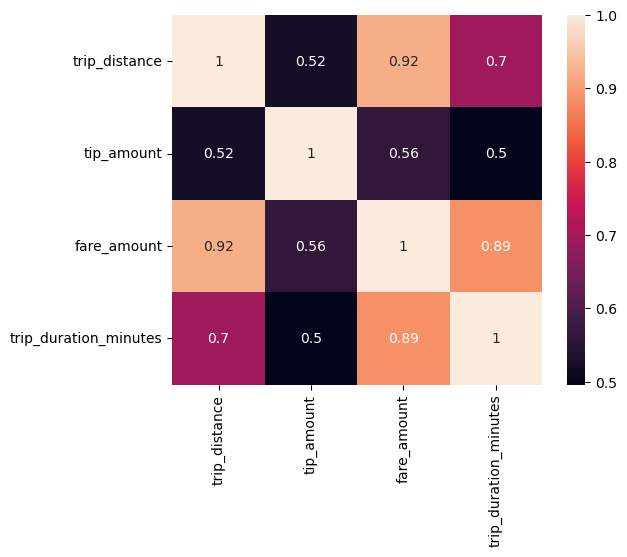

In [26]:
sns.heatmap(taxi_data_df.corr(),square=True,annot=True)

In [27]:
taxi_data_pred_df.corr()

,trip_distance,tip_amount,fare_amount,trip_duration_minutes,prediction
trip_distance,1.000000,0.521603,0.919666,0.696026,0.460544
tip_amount,0.521603,1.000000,0.561476,0.495970,0.309112
fare_amount,0.919666,0.561476,1.000000,0.885024,0.523014
trip_duration_minutes,0.696026,0.495970,0.885024,1.000000,0.502238
prediction,0.460544,0.309112,0.523014,0.502238,1.000000


In [28]:
taxi_data_pred_df.hvplot.scatter(x='trip_duration_minutes',y='fare_amount',by='prediction')

:NdOverlay   [prediction]
   :Scatter   [trip_duration_minutes]   (fare_amount)

In [29]:
k = range(1,10)
inertia = []
for i in k:
    model = KMeans(n_clusters=i,random_state=1)
    model.fit(taxi_data_df)
    inertia.append(model.inertia_)

elbow_df = pd.DataFrame({'k':k,'inertia':inertia})
elbow_df.hvplot(x='k',y='inertia')

:Curve   [k]   (inertia)

In [30]:
model = KMeans(n_clusters=4, random_state=1)
model.fit(taxi_data_df)
segments = model.predict(taxi_data_df)
taxi_data_pred_df = taxi_data_df.copy()
taxi_data_pred_df['prediction'] = segments

In [31]:
taxi_data_pred_df.hvplot.scatter(x='trip_duration_minutes',y='fare_amount',by='prediction')

:NdOverlay   [prediction]
   :Scatter   [trip_duration_minutes]   (fare_amount)

In [32]:
green_taxi_tripsh_df = green_taxi_trips_df.groupby(pd.Grouper(key='lpep_pickup_datetime', axis=0, freq='H')).sum()

In [33]:
green_taxi_tripsh_df.isnull().sum()

RatecodeID               0
PULocationID             0
DOLocationID             0
passenger_count          0
trip_distance            0
fare_amount              0
tip_amount               0
tolls_amount             0
total_amount             0
payment_type             0
trip_type                0
trip_duration_minutes    0
dtype: int64

In [34]:
green_taxi_tripsh_2022_df = green_taxi_tripsh_df.loc['2022']

In [35]:
green_taxi_tripsh_2022_df

,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,tip_amount,tolls_amount,total_amount,payment_type,trip_type,trip_duration_minutes
lpep_pickup_datetime,,,,,,,,,,,,
2022-01-01 00:00:00,18.0,1509,2575,21.0,71.06,263.0,55.44,0.00,363.84,18.0,18.0,247.0
2022-01-01 01:00:00,22.0,2546,2324,22.0,65.11,265.0,57.75,0.00,358.45,19.0,19.0,238.0
2022-01-01 02:00:00,21.0,2455,2922,29.0,61.19,242.0,59.49,6.55,354.59,21.0,21.0,228.0
2022-01-01 03:00:00,10.0,919,1390,20.0,40.44,144.0,25.71,0.00,190.96,10.0,10.0,133.0
2022-01-01 04:00:00,9.0,864,1479,9.0,29.81,116.0,24.03,6.55,163.78,9.0,9.0,124.0
...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-31 19:00:00,67.0,6191,9014,87.0,197.12,1103.0,229.17,6.55,1512.37,67.0,67.0,977.0
2022-12-31 20:00:00,61.0,6537,8210,69.0,214.02,1092.6,192.36,13.10,1510.16,61.0,61.0,806.0
2022-12-31 21:00:00,56.0,6252,8063,65.0,153.51,791.4,183.65,3.00,1146.50,56.0,56.0,614.0


In [36]:
from prophet import Prophet

In [37]:
prophet_df = green_taxi_tripsh_2022_df['tip_amount']

In [38]:
prophet_df

lpep_pickup_datetime
2022-01-01 00:00:00     55.44
2022-01-01 01:00:00     57.75
2022-01-01 02:00:00     59.49
2022-01-01 03:00:00     25.71
2022-01-01 04:00:00     24.03
                        ...  
2022-12-31 19:00:00    229.17
2022-12-31 20:00:00    192.36
2022-12-31 21:00:00    183.65
2022-12-31 22:00:00    153.76
2022-12-31 23:00:00     83.48
Freq: H, Name: tip_amount, Length: 8760, dtype: float64

In [39]:
prophet_df.describe()

count    8760.000000
mean      136.700426
std        95.831969
min         0.000000
25%        44.347500
50%       142.445000
75%       208.405000
max       586.580000
Name: tip_amount, dtype: float64

In [40]:
prophet_df = prophet_df.reset_index()

In [41]:
prophet_df.isnull().sum()

lpep_pickup_datetime    0
tip_amount              0
dtype: int64

In [42]:
prophet_df.head()

,lpep_pickup_datetime,tip_amount
0,2022-01-01 00:00:00,55.44
1,2022-01-01 01:00:00,57.75
2,2022-01-01 02:00:00,59.49
3,2022-01-01 03:00:00,25.71
4,2022-01-01 04:00:00,24.03


In [43]:
prophet_df.columns = ['ds','y']

In [44]:
prophet_df

,ds,y
0,2022-01-01 00:00:00,55.44
1,2022-01-01 01:00:00,57.75
2,2022-01-01 02:00:00,59.49
3,2022-01-01 03:00:00,25.71
4,2022-01-01 04:00:00,24.03
...,...,...
8755,2022-12-31 19:00:00,229.17
8756,2022-12-31 20:00:00,192.36
8757,2022-12-31 21:00:00,183.65
8758,2022-12-31 22:00:00,153.76


In [45]:
model_p = Prophet()
display(model_p)

In [46]:
model_p.fit(prophet_df)

19:43:56 - cmdstanpy - INFO - Chain [1] start processing
19:44:00 - cmdstanpy - INFO - Chain [1] done processing


In [47]:
future_df = model_p.make_future_dataframe(24*30,freq='H')

In [48]:
future_df.shape

(9480, 1)

In [49]:
forecast = model_p.predict(future_df)

In [50]:
display(forecast.shape)

(9480, 19)

In [51]:
forecast.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2022-01-01 00:00:00,98.704403,-31.643159,73.785214,98.704403,98.704403,-77.631617,-77.631617,-77.631617,-81.011601,-81.011601,-81.011601,3.379983,3.379983,3.379983,0.0,0.0,0.0,21.072786
1,2022-01-01 01:00:00,98.737403,-49.222657,52.547278,98.737403,98.737403,-97.046572,-97.046572,-97.046572,-99.402976,-99.402976,-99.402976,2.356404,2.356404,2.356404,0.0,0.0,0.0,1.690831
2,2022-01-01 02:00:00,98.770404,-74.868726,35.480207,98.770404,98.770404,-117.471288,-117.471288,-117.471288,-118.758439,-118.758439,-118.758439,1.287151,1.287151,1.287151,0.0,0.0,0.0,-18.700885
3,2022-01-01 03:00:00,98.803404,-83.580102,16.352856,98.803404,98.803404,-133.197187,-133.197187,-133.197187,-133.371139,-133.371139,-133.371139,0.173952,0.173952,0.173952,0.0,0.0,0.0,-34.393784
4,2022-01-01 04:00:00,98.836404,-92.681072,16.474579,98.836404,98.836404,-135.266080,-135.266080,-135.266080,-134.285098,-134.285098,-134.285098,-0.980981,-0.980981,-0.980981,0.0,0.0,0.0,-36.429676


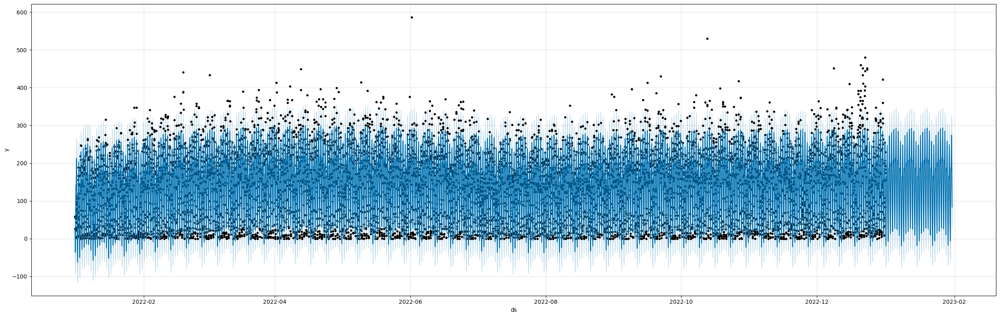

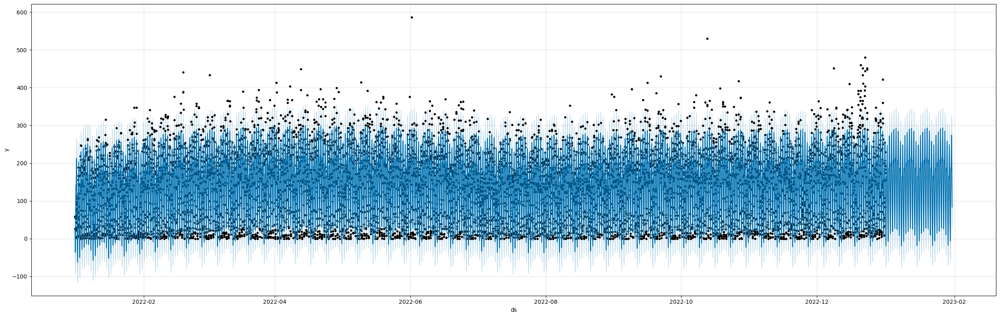

In [52]:
model_p.plot(forecast,figsize=(25,8))

In [53]:
forecast = forecast.set_index('ds')

In [54]:
forecast[['yhat','yhat_lower','yhat_upper']].iloc[-360:,:].hvplot()

:NdOverlay   [Variable]
   :Curve   [ds]   (value)

In [55]:
forecast = forecast.reset_index()

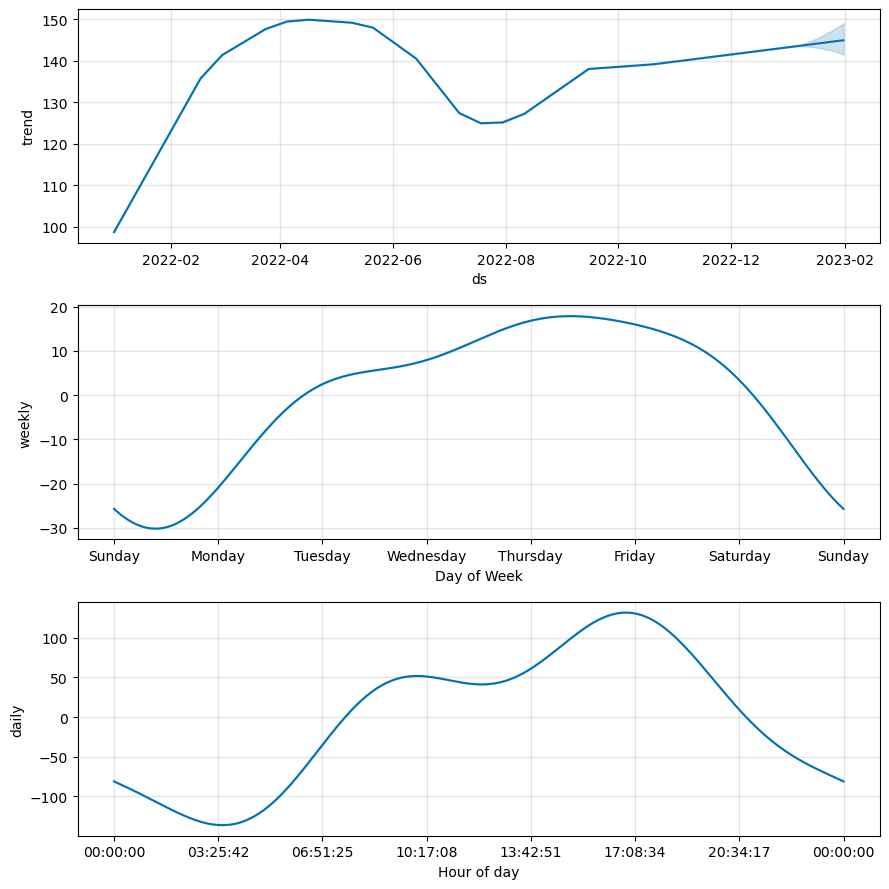

In [56]:
fig2 = model_p.plot_components(forecast)

In [57]:
from sklearn import preprocessing

In [58]:
green_taxi_2022_hourly_df = green_taxi_tripsh_2022_df[['passenger_count',
                                                       'trip_distance',
                                                       'trip_duration_minutes',
                                                       'fare_amount',
                                                       'tolls_amount',
                                                       'total_amount',
                                                       'payment_type',
                                                       'trip_type',
                                                       'tip_amount']]

In [59]:
green_taxi_2022_hourly_df = green_taxi_2022_hourly_df.reset_index()

In [60]:
green_taxi_2022_hourly_df.drop(columns=['lpep_pickup_datetime'], inplace=True)

In [73]:
green_taxi_2022_hourly_df.tail()

,passenger_count,trip_distance,trip_duration_minutes,fare_amount,tolls_amount,total_amount,payment_type,trip_type,tip_amount
8755,87.0,197.12,977.0,1103.0,6.55,1512.37,67.0,67.0,229.17
8756,69.0,214.02,806.0,1092.6,13.10,1510.16,61.0,61.0,192.36
8757,65.0,153.51,614.0,791.4,3.00,1146.50,56.0,56.0,183.65
8758,59.0,161.39,624.0,825.1,0.00,1114.76,47.0,47.0,153.76
8759,30.0,73.22,297.0,396.2,0.00,568.93,26.0,26.0,83.48


In [61]:
robust_scaler = preprocessing.RobustScaler()
robust_scaler_df = robust_scaler.fit_transform(green_taxi_2022_hourly_df)

In [62]:
robust_scaler_df = pd.DataFrame(robust_scaler_df, columns=green_taxi_2022_hourly_df.columns)
robust_scaler_df

,passenger_count,trip_distance,trip_duration_minutes,fare_amount,tolls_amount,total_amount,payment_type,trip_type,tip_amount
0,-0.600000,-0.514091,-0.469964,-0.520820,-0.500000,-0.520302,-0.578947,-0.578947,-0.530332
1,-0.586667,-0.550231,-0.478649,-0.518176,-0.500000,-0.525417,-0.561404,-0.561404,-0.516252
2,-0.493333,-0.574040,-0.488299,-0.548579,0.000000,-0.529080,-0.526316,-0.526316,-0.505646
3,-0.613333,-0.700073,-0.579976,-0.678123,-0.500000,-0.684351,-0.719298,-0.719298,-0.711549
4,-0.760000,-0.764638,-0.588661,-0.715135,0.000000,-0.710143,-0.736842,-0.736842,-0.721790
...,...,...,...,...,...,...,...,...,...
8755,0.280000,0.251579,0.234499,0.589557,0.000000,0.569561,0.280702,0.280702,0.528626
8756,0.040000,0.354227,0.069481,0.575810,0.500000,0.567463,0.175439,0.175439,0.304253
8757,-0.013333,-0.013302,-0.115802,0.177660,-0.270992,0.222379,0.087719,0.087719,0.251162
8758,-0.093333,0.034560,-0.106152,0.222208,-0.500000,0.192261,-0.070175,-0.070175,0.068970


In [63]:
standard_scaler = preprocessing.StandardScaler()
standard_scaler_df = standard_scaler.fit_transform(robust_scaler_df)

In [64]:
standard_scaler_df = pd.DataFrame(standard_scaler_df,columns=robust_scaler_df.columns)

In [65]:
standard_scaler_df

,passenger_count,trip_distance,trip_duration_minutes,fare_amount,tolls_amount,total_amount,payment_type,trip_type,tip_amount
0,-0.960836,-0.780832,-0.733588,-0.840448,-0.893618,-0.838867,-0.917020,-0.917020,-0.847995
1,-0.937656,-0.843603,-0.743869,-0.835829,-0.893618,-0.847652,-0.886558,-0.886558,-0.823889
2,-0.775391,-0.884958,-0.755292,-0.888938,-0.284054,-0.853944,-0.825633,-0.825633,-0.805731
3,-0.984017,-1.103864,-0.863814,-1.115229,-0.893618,-1.120657,-1.160720,-1.160720,-1.158244
4,-1.239003,-1.216008,-0.874095,-1.179884,-0.284054,-1.164960,-1.191182,-1.191182,-1.175775
...,...,...,...,...,...,...,...,...,...
8755,0.569084,0.549065,0.100316,1.099188,-0.284054,1.033209,0.575639,0.575639,0.964969
8756,0.151833,0.727355,-0.095023,1.075174,0.325509,1.029607,0.392865,0.392865,0.580837
8757,0.059111,0.088992,-0.314351,0.379676,-0.614428,0.436850,0.240552,0.240552,0.489944
8758,-0.079973,0.172124,-0.302928,0.457492,-0.893618,0.385114,-0.033610,-0.033610,0.178026


In [66]:
from sklearn.model_selection import train_test_split

In [67]:
y = standard_scaler_df['tip_amount']
X = standard_scaler_df.drop(columns=['tip_amount']).copy()

In [68]:
X

,passenger_count,trip_distance,trip_duration_minutes,fare_amount,tolls_amount,total_amount,payment_type,trip_type
0,-0.960836,-0.780832,-0.733588,-0.840448,-0.893618,-0.838867,-0.917020,-0.917020
1,-0.937656,-0.843603,-0.743869,-0.835829,-0.893618,-0.847652,-0.886558,-0.886558
2,-0.775391,-0.884958,-0.755292,-0.888938,-0.284054,-0.853944,-0.825633,-0.825633
3,-0.984017,-1.103864,-0.863814,-1.115229,-0.893618,-1.120657,-1.160720,-1.160720
4,-1.239003,-1.216008,-0.874095,-1.179884,-0.284054,-1.164960,-1.191182,-1.191182
...,...,...,...,...,...,...,...,...
8755,0.569084,0.549065,0.100316,1.099188,-0.284054,1.033209,0.575639,0.575639
8756,0.151833,0.727355,-0.095023,1.075174,0.325509,1.029607,0.392865,0.392865
8757,0.059111,0.088992,-0.314351,0.379676,-0.614428,0.436850,0.240552,0.240552
8758,-0.079973,0.172124,-0.302928,0.457492,-0.893618,0.385114,-0.033610,-0.033610


In [69]:
y

0      -0.847995
1      -0.823889
2      -0.805731
3      -1.158244
4      -1.175775
          ...   
8755    0.964969
8756    0.580837
8757    0.489944
8758    0.178026
8759   -0.555383
Name: tip_amount, Length: 8760, dtype: float64

In [70]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.33, random_state=1)

In [122]:
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
import sklearn.metrics as met

In [87]:
X = green_taxi_2022_hourly_df.drop(columns=['tip_amount']).copy()
y = green_taxi_2022_hourly_df['tip_amount'].copy()

In [96]:
model_lr = LinearRegression()

In [88]:
X_train,X_test,y_train,y_test = train_test_split(X,y,random_state=1)

In [93]:
display(X_train.shape)

(6570, 8)

In [94]:
display(X_test.shape)

(2190, 8)

In [97]:
model_lr.fit(X_train, y_train)

LinearRegression()

In [113]:
y_pred = model_lr.predict(X_test)
display(y_pred.shape)

(2190,)

In [116]:
X_test['pred_tip_amount'] = y_pred
X_test['actual_tip_amount'] = y_test

In [119]:
display(r2_score(y_test, y_pred))

0.9856025130956709